[View in Colaboratory](https://colab.research.google.com/github/toanchitran/tensorflow/blob/master/Build_Neural_Network_with_Numpy.ipynb)

# Build my own neural network with Numpy

In [0]:
import numpy as np
from IPython.display import Image

In [2]:
import os
from sklearn.datasets import make_moons
from sklearn.model_selection import train_test_split

import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D
sns.set_style("whitegrid")

import keras
from keras.models import Sequential
from keras.layers import Dense
from keras.utils import np_utils
from keras import regularizers

from sklearn.metrics import accuracy_score

Using TensorFlow backend.


## Initiation of neural network layers

In [0]:
NN_ARCHITECTURE = [
    {"input_dim":2, "output_dim": 25, "activation":"relu"},
    {"input_dim":25, "output_dim": 50, "activation":"relu"},
    {"input_dim":50, "output_dim": 50, "activation":"relu"},
    {"input_dim":50, "output_dim": 25, "activation":"relu"},
    {"input_dim":25, "output_dim": 1, "activation":"sigmoid"}
]

In [0]:
def init_layers(nn_architecture, seed=99):
  np.random.seed(seed)
  number_of_layers = len(nn_architecture)
  params_values = {}
  
  for idx, layer in enumerate(nn_architecture):
    layer_idx = idx + 1
    
    layer_input_size = layer["input_dim"]
    layer_output_size = layer["output_dim"]
    
    params_values['W'+str(layer_idx)] = np.random.randn(layer_output_size, layer_input_size)*0.1
    params_values['b'+str(layer_idx)] = np.random.randn(layer_output_size, 1)*0.1
    
  return params_values

## Activation function

In [0]:
def sigmoid(Z):
  return 1/(1+np.exp(-Z))

def relu(Z):
  return np.maximum(0,Z)

def sigmoid_backward(dA,Z):
  return dA * sigmoid(Z) * (1-sigmoid(Z))

def relu_backward(dA,Z):
  dZ = np.array(dA, copy=True)
  dZ[Z<=0] = 0
  return dZ

## Forward propagation

In [0]:
def single_layer_forward_propagation(A_prev, W_curr, b_curr, activation="relu"):
  Z_curr = np.dot(W_curr, A_prev) + b_curr
  
  if activation is "relu":
    activation_func = relu
  elif activation is "sigmoid":
    activation_func = sigmoid
  else:
    raise Exception('Non-supported activation function')
    
  return activation_func(Z_curr), Z_curr

In [0]:
def full_forward_propagation(X, params_values, nn_architecture):
  memory = {}
  A_curr = X
  
  for idx, layer in enumerate(nn_architecture):
    layer_idx = idx + 1
    A_prev = A_curr
    
    activ_func_curr = layer["activation"]
    W_curr = params_values["W"+str(layer_idx)]
    b_curr = params_values["b"+str(layer_idx)]
    A_curr,Z_curr = single_layer_forward_propagation(A_prev, W_curr, b_curr, activ_func_curr)
    
    memory["A"+str(idx)]=A_prev
    memory["Z"+str(layer_idx)]=Z_curr
    
  return A_curr, memory

## Calculating cost

In order to monitor our progress and make sure that we are moving in desired direction, we should routinely calculate the value of the loss function. "Generally speaking, the loss function is designed to show how far we are from the 'ideal' solution." It is selected according to the problem we plan to solve, and frameworks such as Keras have many options to choose from. Because I am planning to test our NN for the classification of points between two classes, I decided to use binary crossentropy,

In [0]:

def get_cost_value(Y_hat, Y):
  m=Y_hat.shape[1]
  cost = -1 / m * (np.dot(Y, np.log(Y_hat).T) + np.dot(1 - Y, np.log(1 - Y_hat).T))
  return np.squeeze(cost)

## Calculating accuracy

In [0]:
def convert_prob_into_class(probs):
  probs_ = np.copy(probs)
  probs_[probs_ > 0.5] = 1
  probs_[probs_ <= 0.5] = 0
  return probs_

In [0]:
def get_accuracy_value(Y_hat, Y):
  Y_hat_ = convert_prob_into_class(Y_hat)
  return (Y_hat_ == Y).all(axis=0).mean()

## Backward Propagation

In [0]:
def single_layer_backward_propagation(dA_curr, W_curr, b_curr, Z_curr, A_prev, activation="relu"):
  m = A_prev.shape[1]
  
  if activation is "relu":
    backward_activation_func = relu_backward
  elif activation is "sigmoid":
    backward_activation_func = sigmoid_backward
  else:
    raise Exception('Non-supported activation function')
    
  dZ_curr = backward_activation_func(dA_curr, Z_curr)
  
  dW_curr = np.dot(dZ_curr, A_prev.T)/m
  db_curr = np.sum(dZ_curr, axis=1, keepdims=True)/m
  dA_prev = np.dot(W_curr.T, dZ_curr)
  
  return dA_prev, dW_curr, db_curr

In [0]:
def full_backward_propagation(Y_hat, Y, memory, params_values, nn_architecture):
  grads_values = {}
  
  m = Y.shape[1]
  Y = Y.reshape(Y_hat.shape)
  
  #initiation of gradient descent algorithm
  dA_prev = - (np.divide(Y, Y_hat) - np.divide(1-Y, 1-Y_hat))
  
  for layer_idx_prev, layer in reversed(list(enumerate(nn_architecture))):
    layer_idx_curr = layer_idx_prev + 1
    activ_func_curr = layer["activation"]
    
    dA_curr = dA_prev
    
    A_prev = memory["A"+str(layer_idx_prev)]
    Z_curr = memory["Z"+str(layer_idx_curr)]
    
    W_curr = params_values["W"+str(layer_idx_curr)]
    b_curr = params_values["b"+str(layer_idx_curr)]
    
    dA_prev, dW_curr, db_curr = single_layer_backward_propagation(dA_curr, W_curr, b_curr, Z_curr, A_prev, activ_func_curr)
    
    grads_values["dW"+str(layer_idx_curr)] = dW_curr
    grads_values["db"+str(layer_idx_curr)] = db_curr
    
  return grads_values

##Updating parameters values

In [0]:
def update(params_values, grads_values, nn_architecture, learning_rate):
  
  for idx, layer in enumerate(nn_architecture):
    layer_idx = idx + 1
    
    params_values["W"+str(layer_idx)] -= learning_rate * grads_values["dW"+str(layer_idx)]
    params_values["b"+str(layer_idx)] -= learning_rate * grads_values["db"+str(layer_idx)]
    
  return params_values

## Putting things together
<a href="https://ibb.co/dwWz1L"><img src="https://preview.ibb.co/iMaRgL/blueprint.gif" alt="blueprint" border="0"></a><br />



In [0]:
def my_train(X, Y, nn_architecture, epochs, learning_rate, verbose=False, callback=None):
  params_values = init_layers(nn_architecture, 2)
  cost_history = []
  accuracy_history = []
  
  for i in range(epochs):
    Y_hat, cache = full_forward_propagation(X, params_values, nn_architecture)
    
    cost = get_cost_value(Y_hat, Y)
    cost_history.append(cost)
    accuracy = get_accuracy_value(Y_hat, Y)
    accuracy_history.append(accuracy)
    
    grads_values = full_backward_propagation(Y_hat, Y, cache, params_values, nn_architecture)
    params_values = update(params_values, grads_values, nn_architecture, learning_rate)
    
    if (i%50 == 0):
      if(verbose):
        print("Iteration: {:05} - cost: {:.5f} - accuracy: {:.5f}".format(i, cost, accuracy))
      if(callback is not None):
        callback(i, params_values)
        
  return params_values

#Create dummy dataset

## Plot

In [0]:
# the function making up the graph of a dataset
def make_plot(X, y, plot_name, file_name=None, XX=None, YY=None, preds=None, dark=False):
    if (dark):
        plt.style.use('dark_background')
    else:
        sns.set_style("whitegrid")
    plt.figure(figsize=(16,12))
    axes = plt.gca()
    axes.set(xlabel="$X_1$", ylabel="$X_2$")
    plt.title(plot_name, fontsize=30)
    plt.subplots_adjust(left=0.20)
    plt.subplots_adjust(right=0.80)
    if(XX is not None and YY is not None and preds is not None):
        plt.contourf(XX, YY, preds.reshape(XX.shape), 25, alpha = 1, cmap=cm.Spectral)
        plt.contour(XX, YY, preds.reshape(XX.shape), levels=[.5], cmap="Greys", vmin=0, vmax=.6)
    plt.scatter(X[:, 0], X[:, 1], c=y.ravel(), s=40, cmap=plt.cm.Spectral, edgecolors='black')
    if(file_name):
        plt.savefig(file_name)
        plt.close()


## Dummy dataset

In [0]:
N_SAMPLES = 1000
TEST_SIZE = 0.1

X, y = make_moons(n_samples = N_SAMPLES, noise=0.4, random_state=100)
X_train, X_test, y_train, y_test= train_test_split(X, y, test_size=TEST_SIZE, random_state=42)

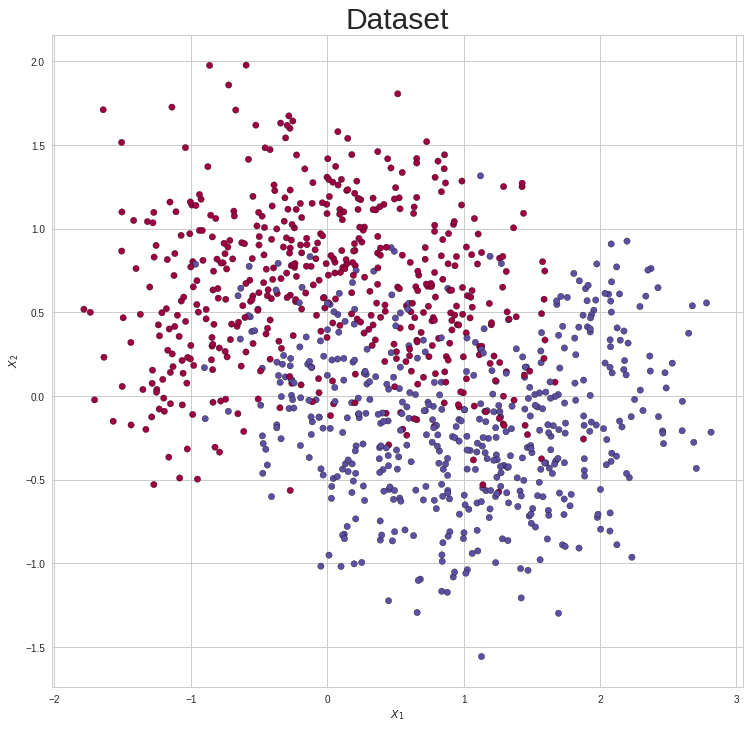

In [17]:
make_plot(X, y, "Dataset")

#David vs Goliath

##David - My neural network

In [0]:
#Training
params_values = my_train(np.transpose(X_train), np.transpose(y_train.reshape((y_train.shape[0], 1))), NN_ARCHITECTURE, 10000, 0.01)

In [0]:
# Prediction
Y_test_hat, _ = full_forward_propagation(np.transpose(X_test), params_values, NN_ARCHITECTURE)

In [20]:
# Accuracy achieved on the test set
acc_test = get_accuracy_value(Y_test_hat, np.transpose(y_test.reshape((y_test.shape[0], 1))))
print("David - Test set accuarcy: {:.2f}".format(acc_test))

David - Test set accuarcy: 0.84


## Goliath - Keras network

In [0]:
model= Sequential()
model.add(Dense(25, input_dim=2, activation='relu'))
model.add(Dense(50, activation='relu'))
model.add(Dense(50, activation='relu'))
model.add(Dense(50, activation='relu'))
model.add(Dense(1, activation='sigmoid'))

model.compile(loss='binary_crossentropy', optimizer="sgd", metrics=['accuracy'])

In [0]:
#Training
history = model.fit(X_train, y_train, epochs=200, verbose=0)

In [23]:
#Prediction
Y_test_hat = model.predict_classes(X_test)
acc_test = accuracy_score(y_test, Y_test_hat)
print("Goliath - Test set accuracy: {:.2f}".format(acc_test))

Goliath - Test set accuracy: 0.83


#Visualization of the learning process

In [0]:
# boundary of the graph
GRID_X_START = -1.5
GRID_X_END = 2.5
GRID_Y_START = -1.0
GRID_Y_END = 2

grid = np.mgrid[GRID_X_START:GRID_X_END:100j,GRID_X_START:GRID_Y_END:100j]
grid_2d = grid.reshape(2, -1).T
XX, YY = grid

/usr/local/lib/python3.6/dist-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


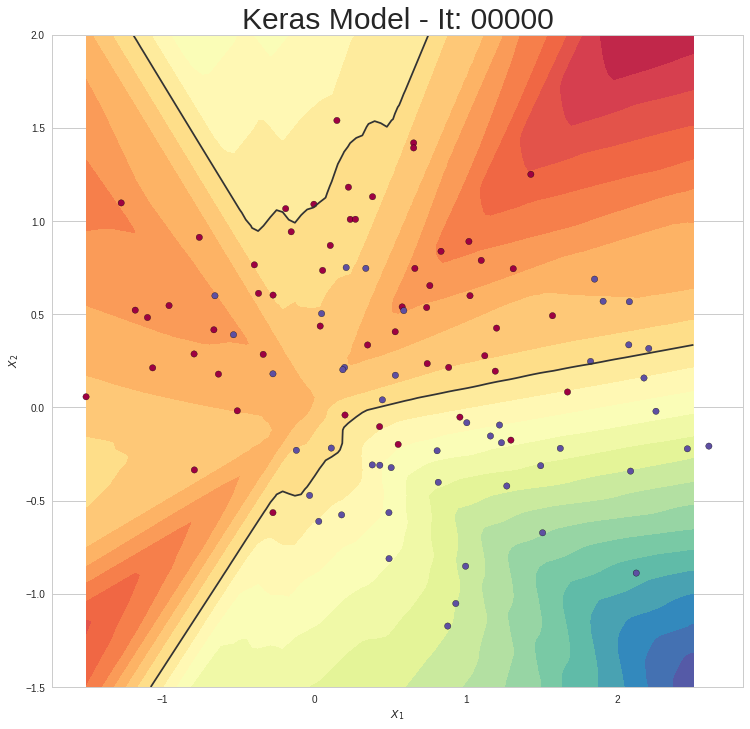

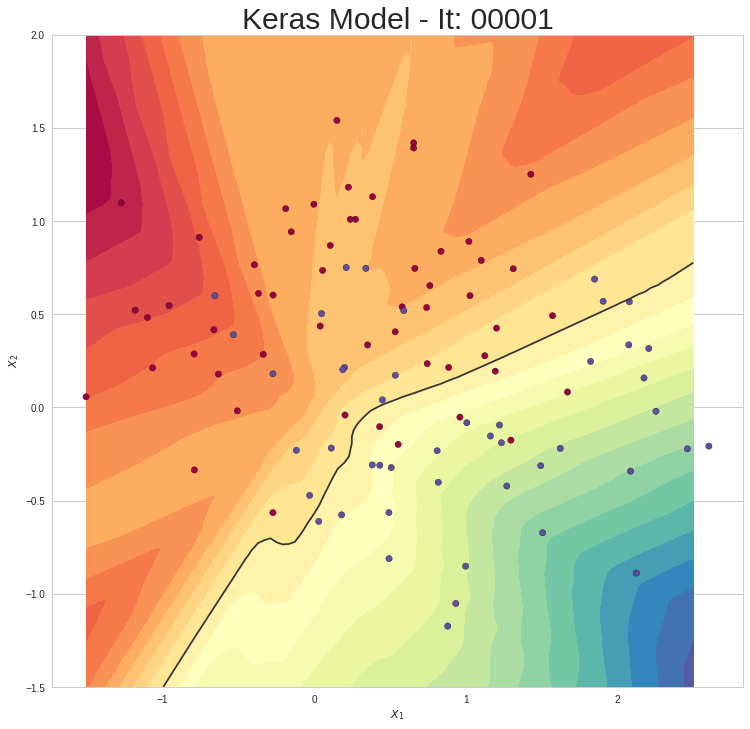

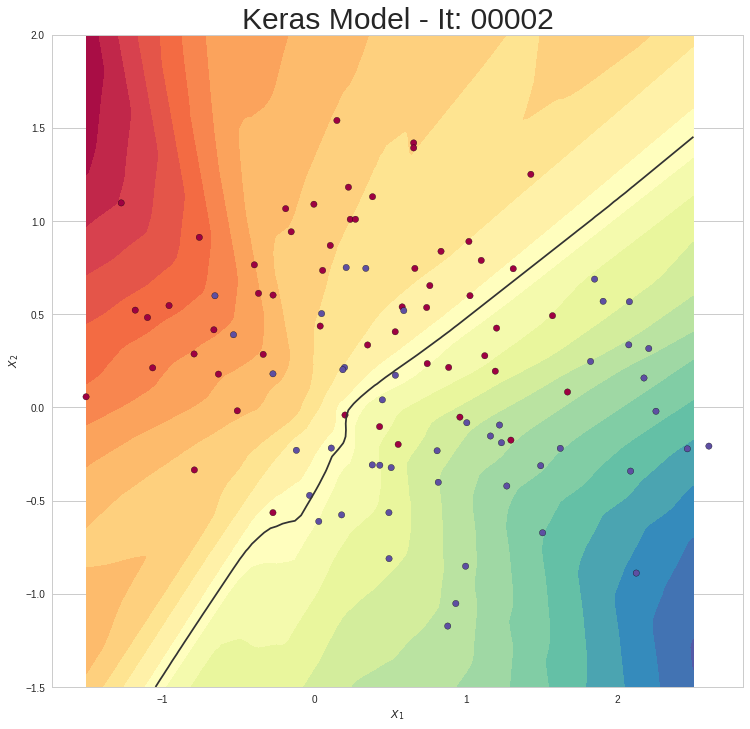

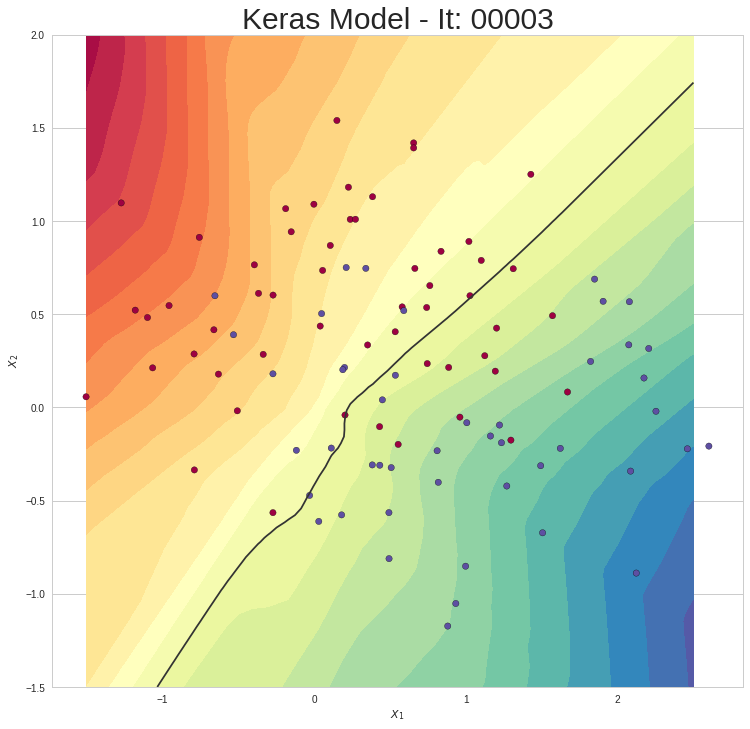

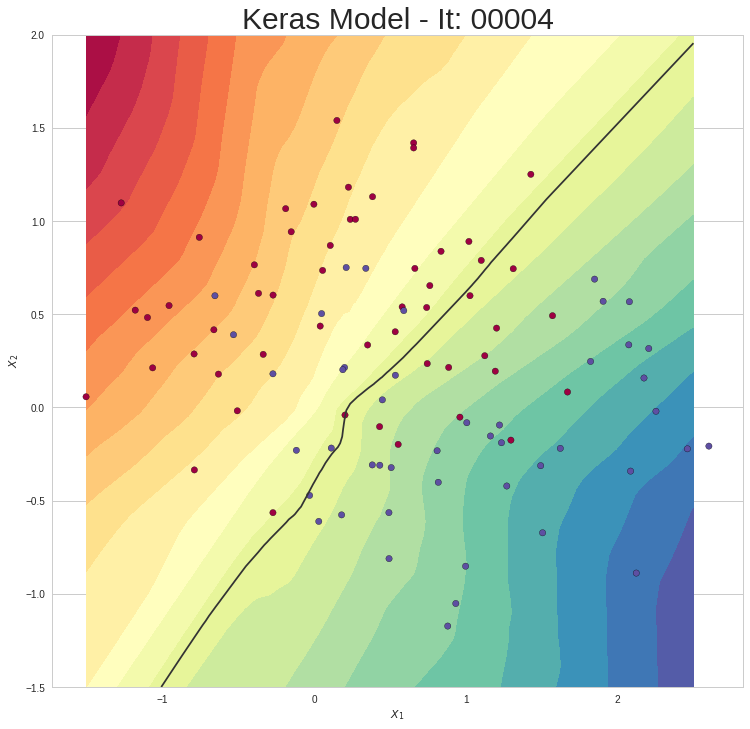

...

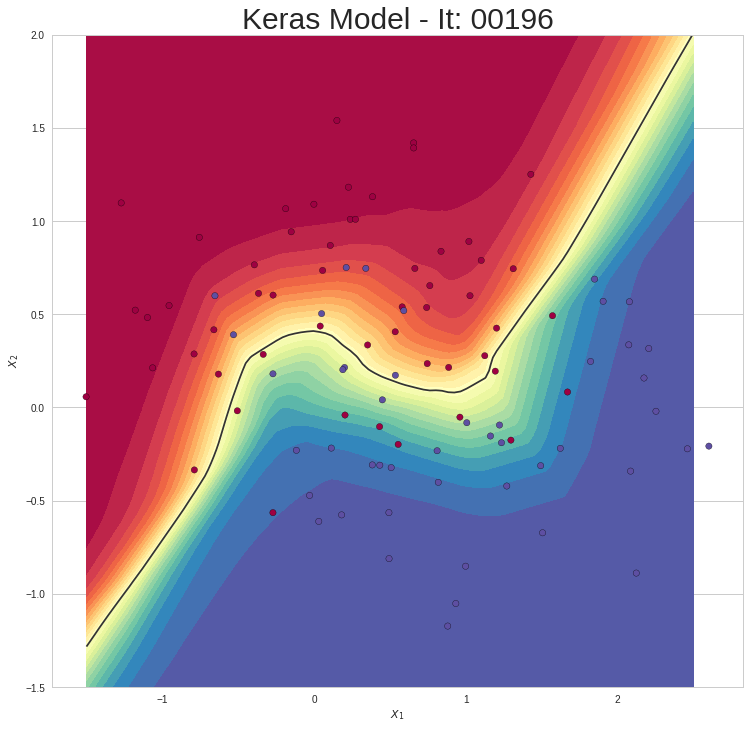

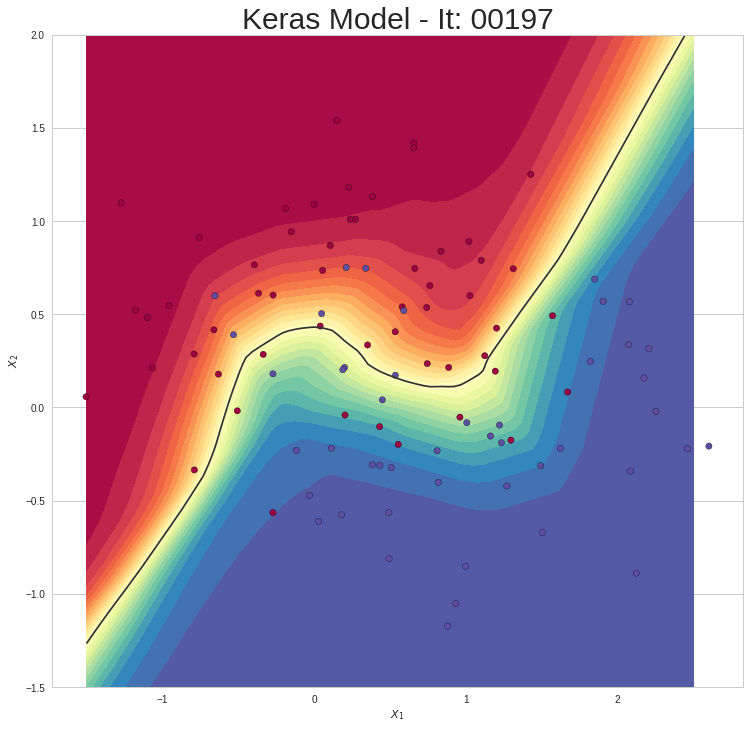

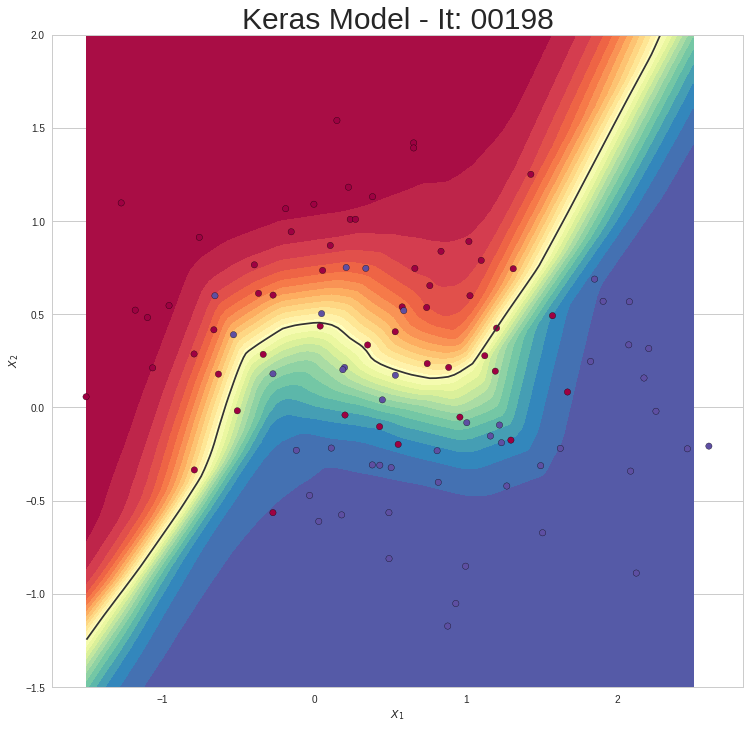

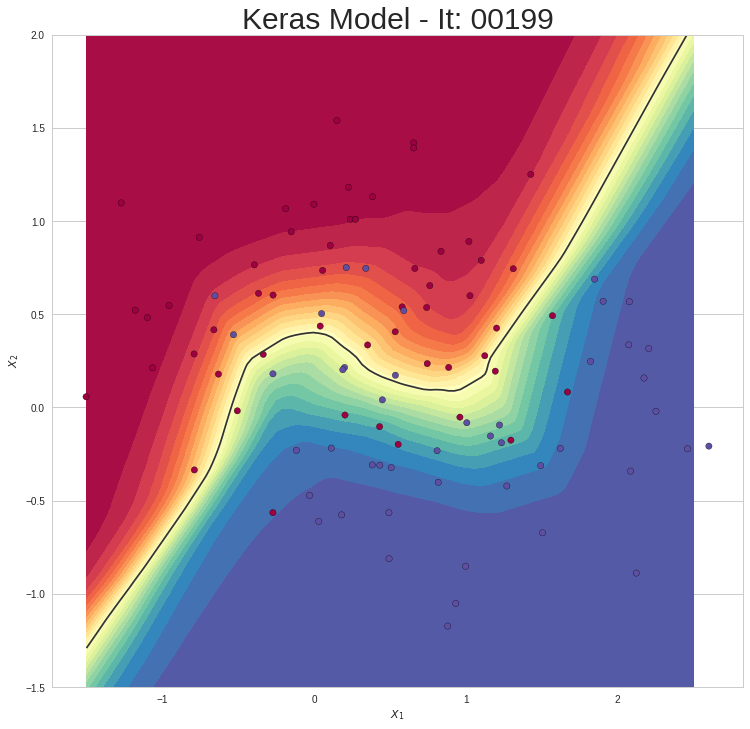

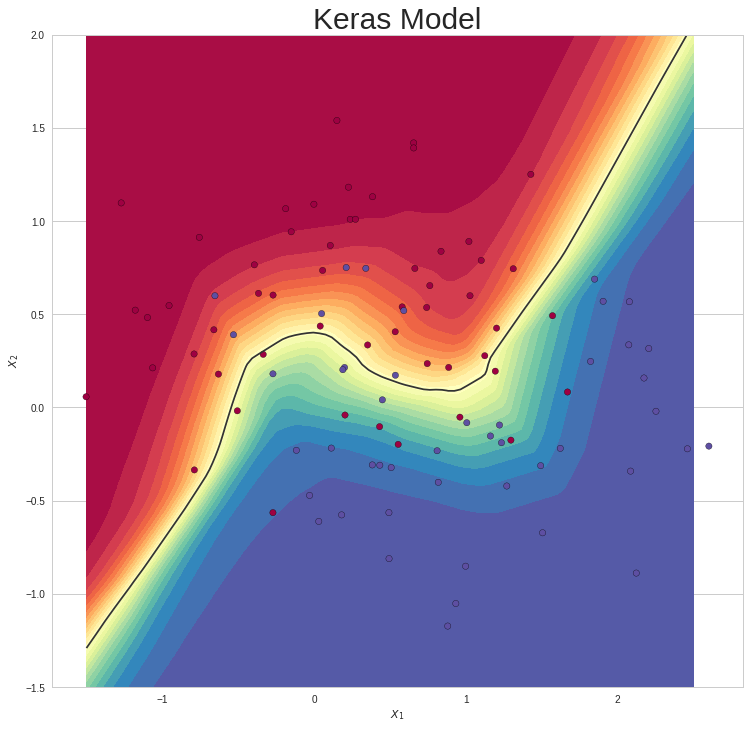

In [25]:
#Keras model

def callback_keras_plot(epoch, logs):
    plot_title = "Keras Model - It: {:05}".format(epoch)
    
    prediction_probs = model.predict_proba(grid_2d, batch_size=32, verbose=0)
    make_plot(X_test, y_test, plot_title, XX=XX, YY=YY, preds=prediction_probs)



# Adding callback functions that they will run in every epoch
testmodelcb = keras.callbacks.LambdaCallback(on_epoch_end=callback_keras_plot)

# Building a model
model = Sequential()
model.add(Dense(25, input_dim=2,activation='relu'))
model.add(Dense(50, activation='relu'))
model.add(Dense(50, activation='relu'))
model.add(Dense(25, activation='relu'))
model.add(Dense(1, activation='sigmoid'))

model.compile(loss='binary_crossentropy', optimizer="sgd", metrics=['accuracy'])

# Training
history = model.fit(X_train, y_train, epochs=200, verbose=0, callbacks=[testmodelcb])

prediction_probs = model.predict_proba(grid_2d, batch_size=32, verbose=0)
make_plot(X_test, y_test, "Keras Model", file_name=None, XX=XX, YY=YY, preds=prediction_probs)

/usr/local/lib/python3.6/dist-packages/matplotlib/contour.py:1180: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"
/usr/local/lib/python3.6/dist-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


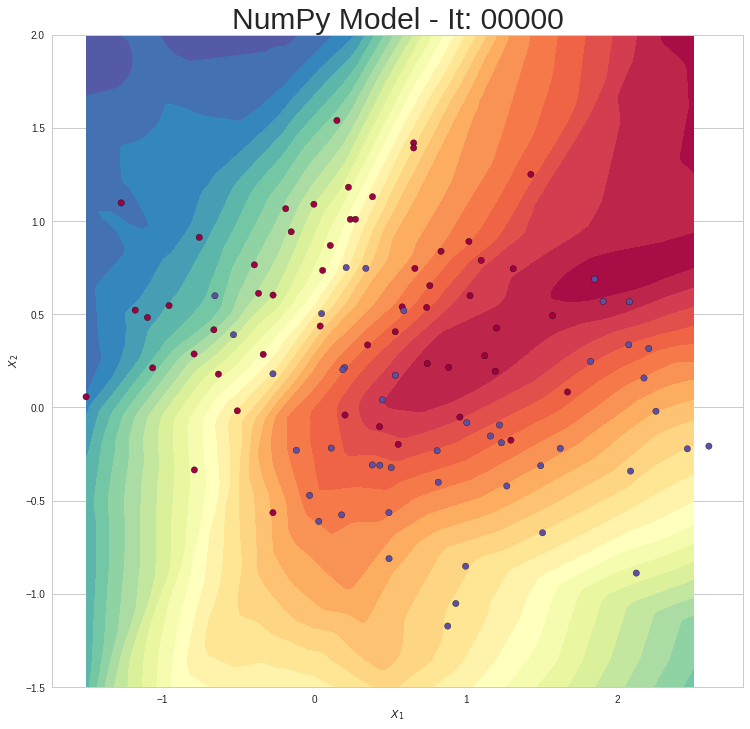

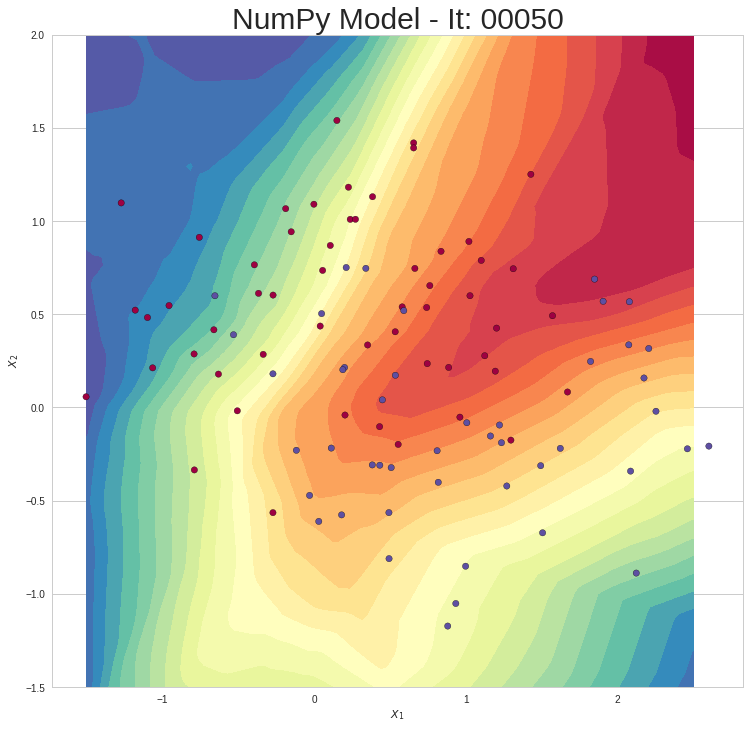

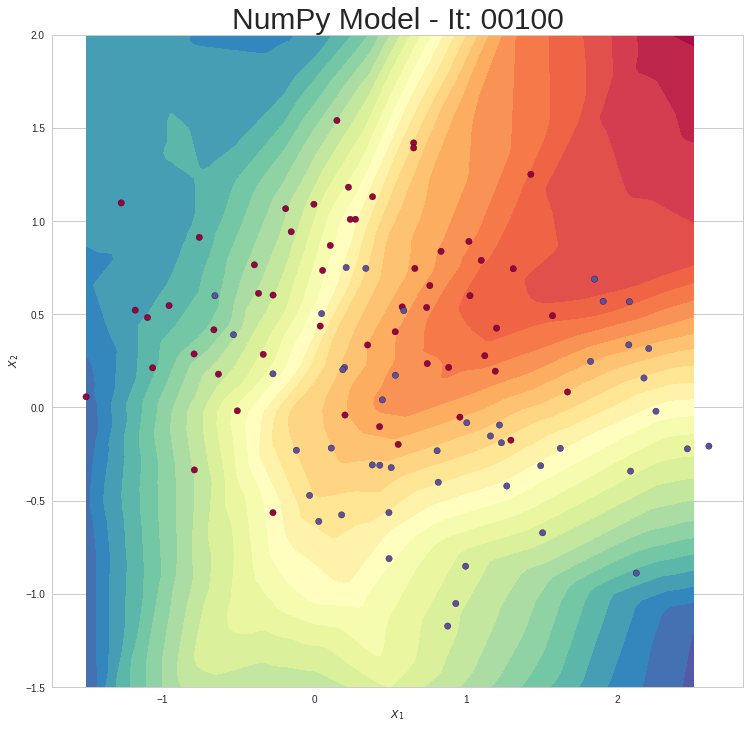

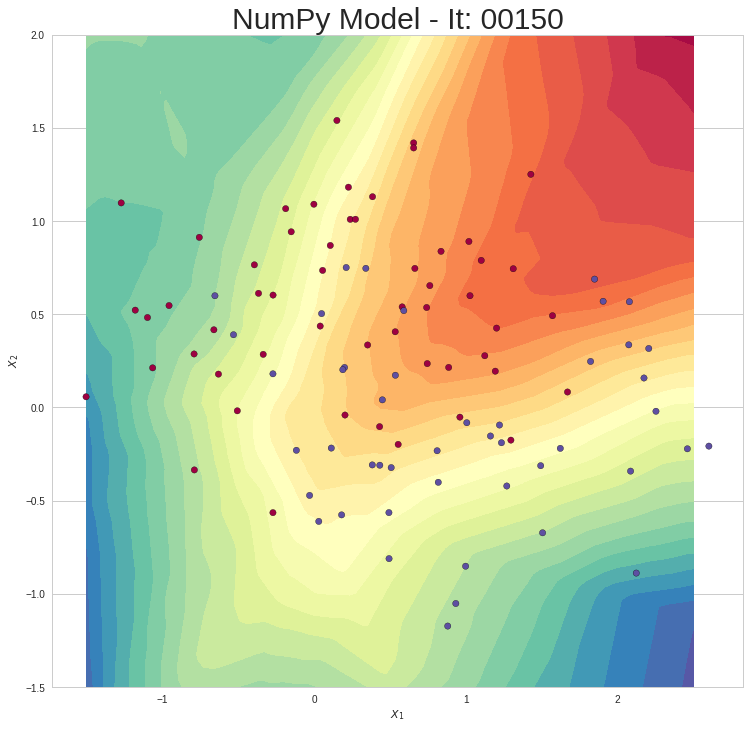

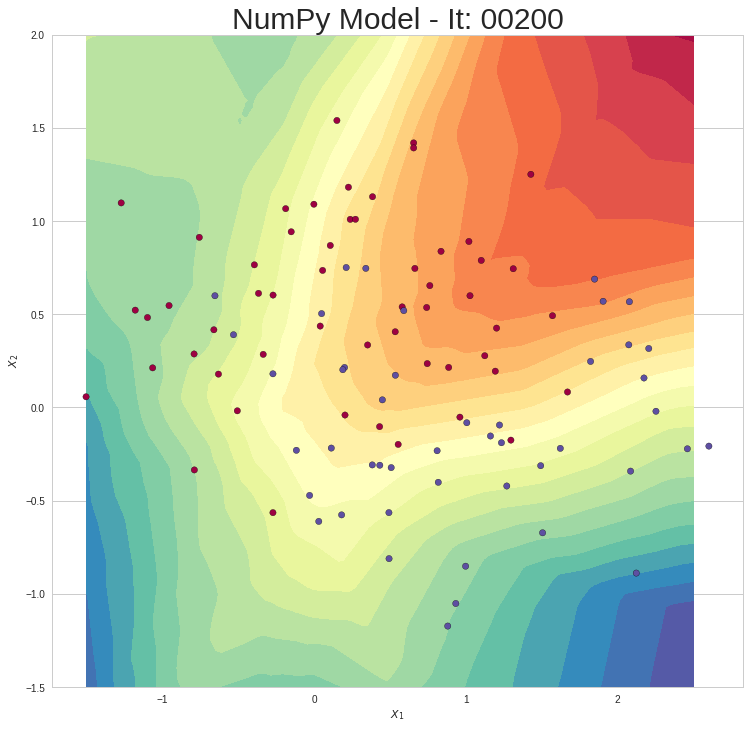

...

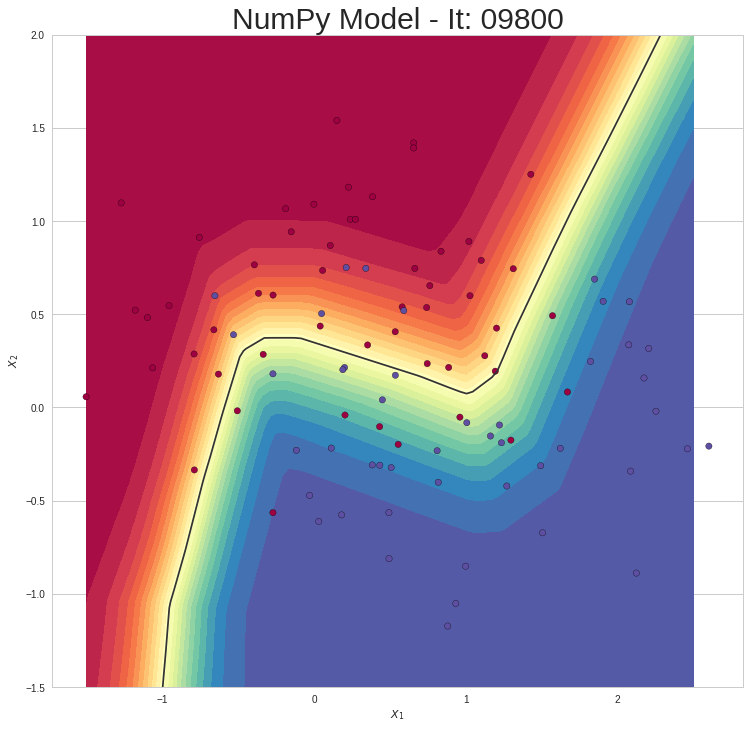

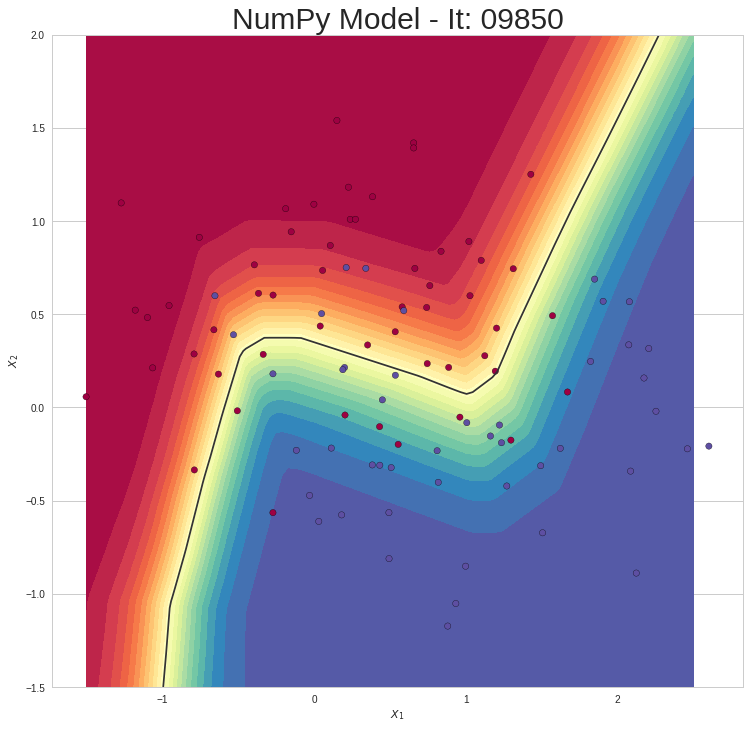

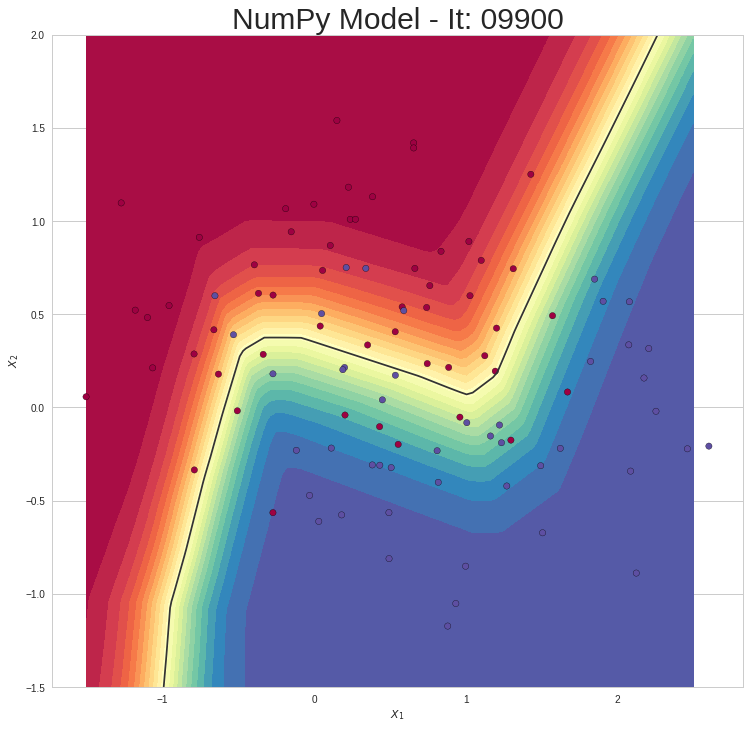

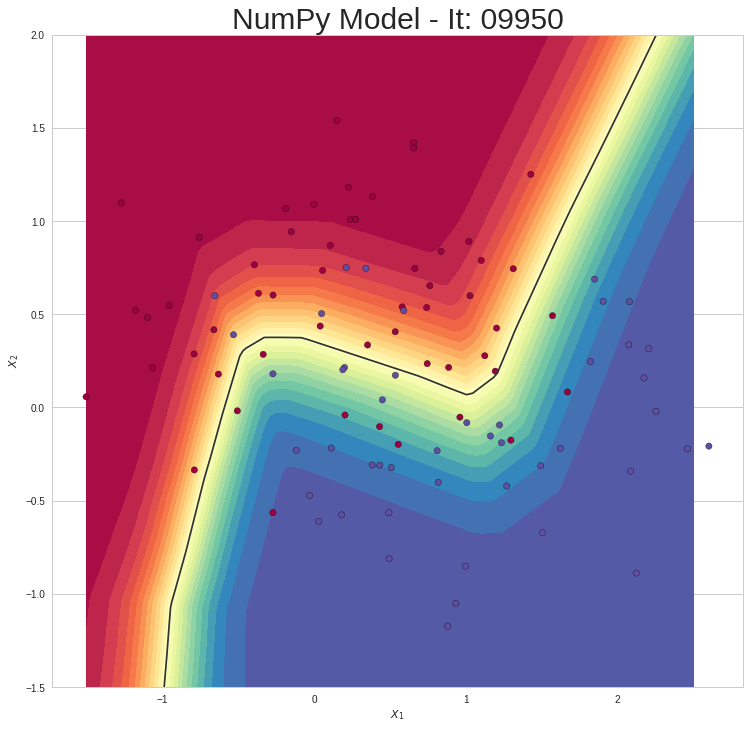

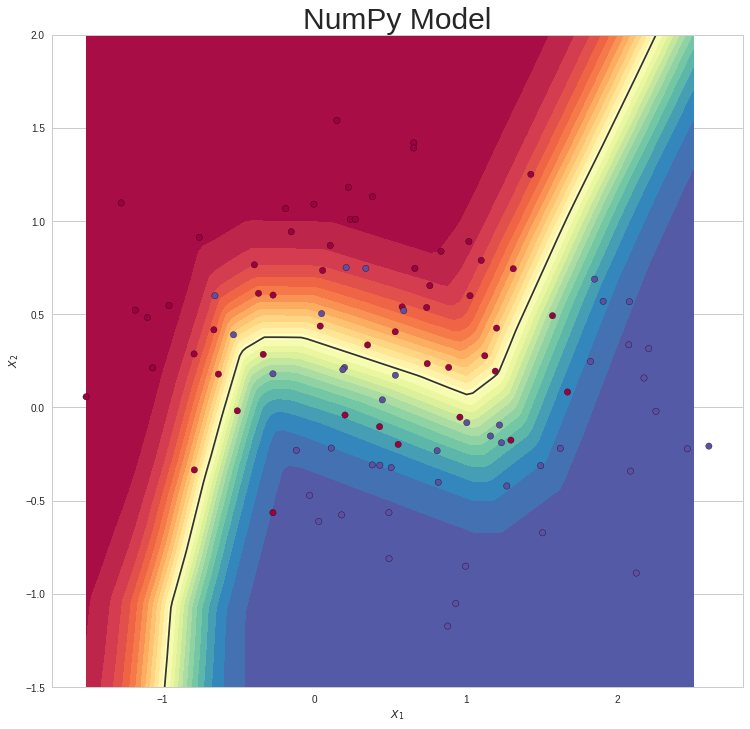

In [26]:
#My model
def callback_numpy_plot(index, params):
    plot_title = "NumPy Model - It: {:05}".format(index)
    
    prediction_probs, _ = full_forward_propagation(np.transpose(grid_2d), params, NN_ARCHITECTURE)
    prediction_probs = prediction_probs.reshape(prediction_probs.shape[1], 1)
    make_plot(X_test, y_test, plot_title, XX=XX, YY=YY, preds=prediction_probs)
    


# Training
params_values = my_train(np.transpose(X_train), np.transpose(y_train.reshape((y_train.shape[0], 1))), NN_ARCHITECTURE, 10000, 0.01, False, callback_numpy_plot)

prediction_probs_numpy, _ = full_forward_propagation(np.transpose(grid_2d), params_values, NN_ARCHITECTURE)
prediction_probs_numpy = prediction_probs_numpy.reshape(prediction_probs_numpy.shape[1], 1)
make_plot(X_test, y_test, "NumPy Model", file_name=None, XX=XX, YY=YY, preds=prediction_probs_numpy)